In [65]:
import os
import io
import warnings
import gzip
import fastavro
from avro.datafile import DataFileReader, DataFileWriter
from avro.io import DatumReader, DatumWriter

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

from astropy.time import Time
from astropy.io import fits
from astropy import units as u

In [2]:
def read_avro_file(file_path):
    with open(file_path, 'rb') as f:
        reader = fastavro.reader(f)
        for record in reader:
            yield record

def display_fits_image(data, title):
    plt.imshow(data, cmap='gray')
    plt.colorbar()
    plt.title(title)
    plt.show()

In [3]:
avro_file_path = '/home/nicolas/astro/ztf-avro-alert/data/2763312025815015071.avro'
records = list(read_avro_file(avro_file_path))

In [4]:
# Verificar el contenido de los datos FITS en el primer registro
cutout_data = records[0]['cutoutScience']['stampData']
print(cutout_data[:100])  # Imprimir los primeros 100 bytes para verificar

b"\x1f\x8b\x08\x00\xf0_\xa3f\x02\x03\xed\xbai\xb8N\xf5\xff\xf7m\n\xc9\x14\x12\x92L!\x99\x93\x90$\xafM\xa6\xccs2\x93\xccI2l\xdb\xde\xe7\xb0\xe6\xb5\xce\xf3\xdc{\x9b\xe7!!d&IB\x12\x19\x92\x84\x94!\xf3\x94$\t\xe9~\xd7\xfd\xec>\xae'\xf7u\xfd\x8f\xebQ\xe7q\xfc\x8e\x9fv\xdb\xdak\xad\xef\xe7\xf3~\xbf^\xd2"


# Mirar qué hay en el archivo avro usando avro

In [36]:
%%time
with open(avro_file_path,'rb') as f:
    freader = DataFileReader(f,DatumReader())
    for packet in freader:
        print(packet.keys())

dict_keys(['schemavsn', 'publisher', 'objectId', 'candid', 'candidate', 'prv_candidates', 'fp_hists', 'cutoutScience', 'cutoutTemplate', 'cutoutDifference'])
CPU times: user 37.7 ms, sys: 1.34 ms, total: 39.1 ms
Wall time: 37.1 ms


# Mirar qué hay en el archivo usando fastavro (es más rápido)

In [37]:
%%time 
with open(avro_file_path,'rb') as f:
    freader = fastavro.reader(f)
    schema = freader.writer_schema

    for packet in freader:
        print(packet.keys())

dict_keys(['schemavsn', 'publisher', 'objectId', 'candid', 'candidate', 'prv_candidates', 'fp_hists', 'cutoutScience', 'cutoutTemplate', 'cutoutDifference'])
CPU times: user 5.49 ms, sys: 439 μs, total: 5.93 ms
Wall time: 5.55 ms


In [7]:
schema

{'version': '4.02',
 'type': 'record',
 'doc': 'avro alert schema for ZTF (www.ztf.caltech.edu)',
 'name': 'ztf.alert',
 'fields': [{'doc': 'schema version used',
   'name': 'schemavsn',
   'type': 'string'},
  {'doc': 'origin of alert packet', 'name': 'publisher', 'type': 'string'},
  {'doc': 'object identifier or name', 'name': 'objectId', 'type': 'string'},
  {'name': 'candid', 'type': 'long'},
  {'name': 'candidate',
   'type': {'version': '4.02',
    'type': 'record',
    'doc': 'avro alert schema',
    'name': 'ztf.alert.candidate',
    'fields': [{'doc': 'Observation Julian date at start of exposure [days]',
      'name': 'jd',
      'type': 'double'},
     {'doc': 'Filter ID (1=g; 2=R; 3=i)', 'name': 'fid', 'type': 'int'},
     {'doc': 'Processing ID for science image to facilitate archive retrieval',
      'name': 'pid',
      'type': 'long'},
     {'default': None,
      'doc': 'Expected 5-sigma mag limit in difference image based on global noise estimate [mag]',
      'name'

In [8]:
packet #Esto es un diccionario

{'schemavsn': '4.02',
 'publisher': 'ZTF (www.ztf.caltech.edu)',
 'objectId': 'ZTF18aavyqcs',
 'candid': 2763312025815015071,
 'candidate': {'jd': 2460517.8120255,
  'fid': 2,
  'pid': 2763312025815,
  'diffmaglim': 20.16545295715332,
  'pdiffimfilename': 'ztf_20240726312025_000687_zr_c15_o_q3_scimrefdiffimg.fits',
  'programpi': 'Kulkarni',
  'programid': 1,
  'candid': 2763312025815015071,
  'isdiffpos': 't',
  'tblid': 71,
  'nid': 2763,
  'rcid': 58,
  'field': 687,
  'xpos': 1392.1903076171875,
  'ypos': 2202.970703125,
  'ra': 304.5229914,
  'dec': 35.6002571,
  'magpsf': 16.30207061767578,
  'sigmapsf': 0.07418662309646606,
  'chipsf': 256.94659423828125,
  'magap': 16.522499084472656,
  'sigmagap': 0.01850000023841858,
  'distnr': 0.6548436880111694,
  'magnr': 14.941999435424805,
  'sigmagnr': 0.017999999225139618,
  'chinr': 0.8769999742507935,
  'sharpnr': -0.03999999910593033,
  'sky': 1.9085090160369873,
  'magdiff': 0.22043000161647797,
  'fwhm': 6.730000019073486,
  'cla

In [9]:
print('JD: {} Filter: {} Mag: {:.2f}+/-{:.2f}'.format(
    packet['candidate']['jd'],packet['candidate']['fid'],
    packet['candidate']['magpsf'],packet['candidate']['sigmapsf']))

JD: 2460517.8120255 Filter: 2 Mag: 16.30+/-0.07


# Extraer lightcurves

In [10]:
def make_dataframe(packet):
    df = pd.DataFrame(packet['candidate'], index=[0])
    df_prv = pd.DataFrame(packet['prv_candidates'])
    return pd.concat([df,df_prv], ignore_index=True)

In [11]:
dflc = make_dataframe(packet)
dflc

/tmp/ipykernel_44011/3624908057.py:4: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  return pd.concat([df,df_prv], ignore_index=True)


,jd,fid,pid,diffmaglim,pdiffimfilename,programpi,programid,candid,isdiffpos,tblid,...,zpmed,clrmed,clrrms,neargaia,neargaiabright,maggaia,maggaiabright,exptime,drb,drbversion
0,2.460518e+06,2,2763312025815,20.165453,ztf_20240726312025_000687_zr_c15_o_q3_scimrefd...,Kulkarni,1,2.763312e+18,t,71.0,...,26.327,1.151,0.186396,7.110457,63.728939,19.218117,13.040307,30.0,0.984834,d6_m7
1,2.460488e+06,2,2733405915815,20.240000,/ztf/archive/sci/2024/0626/405880/ztf_20240626...,Kulkarni,1,NaN,None,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2.460490e+06,2,2735404825815,20.283701,/ztf/archive/sci/2024/0628/404502/ztf_20240628...,Kulkarni,1,2.735405e+18,t,76.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2.460490e+06,1,2735427765815,20.273899,/ztf/archive/sci/2024/0628/427766/ztf_20240628...,Kulkarni,1,2.735428e+18,t,54.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2.460492e+06,1,2737426335815,20.646999,/ztf/archive/sci/2024/0630/426331/ztf_20240630...,Kulkarni,1,2.737426e+18,t,74.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2.460500e+06,2,2745324295815,20.124201,/ztf/archive/sci/2024/0708/324294/ztf_20240708...,Kulkarni,1,2.745324e+18,t,47.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2.460500e+06,1,2745349835815,20.475800,/ztf/archive/sci/2024/0708/349792/ztf_20240708...,Kulkarni,1,2.745350e+18,t,67.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2.460502e+06,2,2747366385815,20.591900,/ztf/archive/sci/2024/0710/366377/ztf_20240710...,Kulkarni,1,2.747366e+18,t,83.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2.460502e+06,1,2747401625815,20.632700,/ztf/archive/sci/2024/0710/401609/ztf_20240710...,Kulkarni,1,2.747402e+18,t,60.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2.460504e+06,1,2749345155815,20.382299,/ztf/archive/sci/2024/0712/345069/ztf_20240712...,Kulkarni,1,2.749345e+18,t,40.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
dflc.columns

Index(['jd', 'fid', 'pid', 'diffmaglim', 'pdiffimfilename', 'programpi',
       'programid', 'candid', 'isdiffpos', 'tblid',
       ...
       'zpmed', 'clrmed', 'clrrms', 'neargaia', 'neargaiabright', 'maggaia',
       'maggaiabright', 'exptime', 'drb', 'drbversion'],
      dtype='object', length=103)

In [13]:
def plot_lightcurve(dflc, days_ago=True):
    
    filter_color = {1:'green', 2:'red', 3:'pink'}
    if days_ago:
        now = Time.now().jd
        t = dflc.jd - now
        xlabel = 'Days Ago'
    else:
        t = dflc.jd
        xlabel = 'Time (JD)'
    
    plt.figure()
    for fid, color in filter_color.items():
        # plot detections in this filter:
        w = (dflc.fid == fid) & ~dflc.magpsf.isnull()
        if np.sum(w):
            plt.errorbar(t[w],dflc.loc[w,'magpsf'], dflc.loc[w,'sigmapsf'],fmt='.',color=color)
        wnodet = (dflc.fid == fid) & dflc.magpsf.isnull()
        if np.sum(wnodet):
            plt.scatter(t[wnodet],dflc.loc[wnodet,'diffmaglim'], marker='v',color=color,alpha=0.25)
    
    plt.gca().invert_yaxis()
    plt.xlabel(xlabel)
    plt.ylabel('Magnitude')

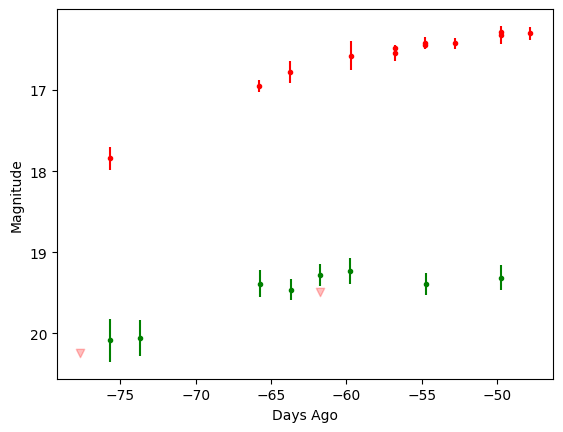

In [14]:
plot_lightcurve(dflc)

In [15]:
packet['cutoutScience']

{'fileName': 'candid2763312025815015071_pid2763312025815_targ_sci.fits.gz',
 'stampData': b'\x1f\x8b\x08\x00\xf0_\xa3f\x02\x03\xed\xbai\xb8N\xf5\xff\xf7m\n\xc9\x14\x12\x92L!\x99\x93\x90$\xafM\xa6\xccs2\x93\xccI2l\xdb\xde\xe7\xb0\xe6\xb5\xce\xf3\xdc{\x9b\xe7!!d&IB\x12\x19\x92\x84\x94!\xf3\x94$\t\xe9~\xd7\xfd\xec>\xae\'\xf7u\xfd\x8f\xebQ\xe7q\xfc\x8e\x9fv\xdb\xdak\xad\xef\xe7\xf3~\xbf^\xd2\xa1\xf9km[5)]\xfa\xa5\xd2\xa5;\x96\xfe\x1f\xf84n\xde\xb1m\xf3\xae\xff^\xef\xff\xfb\xa9\xfa\\\xad\xff\xff\xd7k\xfdJ\xd7\xe6\x1dJ\xff/\xafW\xba\xf4\xff\xee\xf5j\xfe\xaf\xafW\xe7\xb9\xff\xcd\xeb\xd5\xfa\x9f\xbb^\xe3N\xad\x9bw\xfc\xf7y+&\xb5\xfe\x7f\xbfT\xf1\xff\xe4<\x9a\xb4N*\xfd\xdf\xe7\xbf\xcf\x7f\x9f\xff>\xff}\xfe\xfb\xfc\xf7\xf9\xef\xf3\xdf\xe7\x7f\xeeC\xea\xfd\n\x18\xf3wc\xeeo\x86?\xbb\x15\xe6\xf1\xa3L\x7f\xfa0\xf6#\xd9\xb0\x1a\xb7&\xd6s\x0b)!\x93\xd8\xc0\xeex\x03\xdbc\xbcT\x90\xd0\xcfC\xb1\xaf\x84\xf0\xfbNc\xfc\xaa%d\xe6\x8f\xe0,9O|\xea"\xa2\x7f\x17\xc7>\xf1\x0c\xd6\xd9B\x84\x87\x17\'\xad\xc8~b\x9b\

In [16]:
stamp = packet['cutoutScience']['stampData']

In [17]:
type(stamp)

bytes

In [18]:
def plot_cutout(stamp, fig=None, subplot=None, **kwargs):
    with gzip.open(io.BytesIO(stamp), 'rb') as f:
        with fits.open(io.BytesIO(f.read())) as hdul:
            data = hdul[0].data  # Extraer los datos de la imagen FITS
            
            if fig is None:
                fig = plt.figure(figsize=(4, 4))
            if subplot is None:
                subplot = (1, 1, 1)
            
            ax = fig.add_subplot(*subplot)
            
            # Mostrar la imagen usando matplotlib con una escala logarítmica
            ax.imshow(data, cmap='gray', origin='lower', **kwargs)
            
            ax.set_title('FITS Cutout')
            ax.set_xlabel('Pixel X')
            ax.set_ylabel('Pixel Y')

            plt.colorbar(ax.images[0], ax=ax, orientation='vertical')
    
    return ax

<Axes: title={'center': 'FITS Cutout'}, xlabel='Pixel X', ylabel='Pixel Y'>

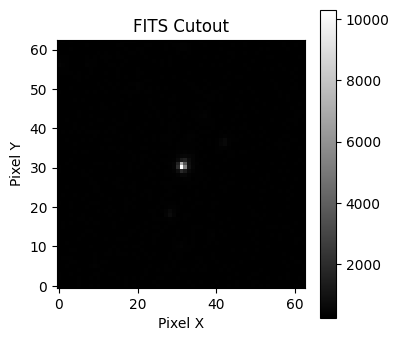

In [19]:
plot_cutout(stamp)

In [20]:
def show_stamps(packet):
    #fig, axes = plt.subplots(1,3, figsize=(12,4))
    fig = plt.figure(figsize=(12,4))
    for i, cutout in enumerate(['Science','Template','Difference']):
        stamp = packet['cutout{}'.format(cutout)]['stampData']
        ffig = plot_cutout(stamp, fig=fig, subplot = (1,3,i+1))
        ffig.set_title(cutout)

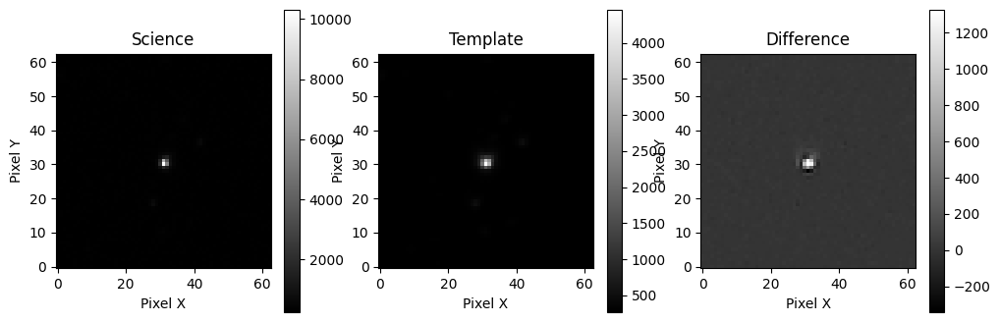

In [21]:
show_stamps(packet)

# Trabajar con archivos descargados

In [22]:
tar_archive = '/home/nicolas/astro/ztf-avro-alert/data/ztf_public_20240726.tar.gz'
output_dir = '/home/nicolas/astro/ztf-avro-alert/data'
#output_dir = tar_archive.split('/')[-1].split('.')[-3]

In [23]:
def find_files(root_dir):
    for dir_name, subdir_list, file_list in os.walk(root_dir, followlinks=True):
        for fname in file_list:
            if fname.endswith('.avro'):
                yield dir_name+'/'+fname

In [24]:
# Contar archivos avro en directorio
print('{} has {} avro files'.format(output_dir, len(list(find_files(output_dir)))))

/home/nicolas/astro/ztf-avro-alert/data has 54921 avro files


In [25]:
def open_avro(fname):
    with open(fname,'rb') as f:
        freader = fastavro.reader(f)
        # in principle there can be multiple packets per file
        for packet in freader:
            yield packet

In [26]:
def generate_dictionaries(root_dir):
    for fname in find_files(root_dir):
        for packet in open_avro(fname):
            yield packet

In [38]:
%%time
from collections import defaultdict
programs = defaultdict(int)
for packet in generate_dictionaries(output_dir):
    programs[packet['candidate']['programid']] += 1
print(programs)

defaultdict(<class 'int'>, {1: 54921})
CPU times: user 3min 22s, sys: 12.8 s, total: 3min 35s
Wall time: 16min 5s


In [39]:
#Filtrar observaciones por parámetros sugeridos por ZTF
def is_alert_pure(packet):
    pure = True
    pure &= packet['candidate']['rb'] >= 0.65
    pure &= packet['candidate']['nbad'] == 0
    pure &= packet['candidate']['fwhm'] <= 5
    pure &= packet['candidate']['elong'] <= 1.2
    pure &= np.abs(packet['candidate']['magdiff']) <= 0.1
    return pure

In [40]:
%%time
programs = defaultdict(int)
for packet in filter(is_alert_pure,generate_dictionaries(output_dir)):
    programs[packet['candidate']['programid']] += 1
print(programs)

defaultdict(<class 'int'>, {1: 14702})
CPU times: user 1min 31s, sys: 1.35 s, total: 1min 32s
Wall time: 1min 32s


In [57]:
def make_dataframe2(packet):
    dfc = pd.DataFrame(packet['candidate'], index=[0])
    df_prv = pd.DataFrame(packet['prv_candidates'])

    # Filtrar columnas que están completamente vacías o con valores NaN
    dfc_clean = dfc.dropna(axis=1, how='all')
    df_prv_clean = df_prv.dropna(axis=1, how='all')    
    
    dflc = pd.concat([dfc_clean,df_prv_clean], ignore_index=True)
    # we'll attach some metadata--not this may not be preserved after all operations
    # https://stackoverflow.com/questions/14688306/adding-meta-information-metadata-to-pandas-dataframe
    dflc.objectId = packet['objectId']
    dflc.candid = packet['candid']
    return dflc

In [58]:
def is_transient(dflc):
    
    candidate = dflc.loc[0]
    
    is_positive_sub = candidate['isdiffpos'] == 't'
    
    if (candidate['distpsnr1'] is None) or (candidate['distpsnr1'] > 1.5):
        no_pointsource_counterpart = True
    else:
        if candidate['sgscore1'] < 0.5:
            no_pointsource_counterpart = True
        else:
            no_pointsource_counterpart = False
            
    where_detected = (dflc['isdiffpos'] == 't') # nondetections will be None
    if np.sum(where_detected) >= 2:
        detection_times = dflc.loc[where_detected,'jd'].values
        dt = np.diff(detection_times)
        not_moving = np.max(dt) >= (30*u.minute).to(u.day).value
    else:
        not_moving = False
    
    no_ssobject = (candidate['ssdistnr'] is None) or (candidate['ssdistnr'] < 0) or (candidate['ssdistnr'] > 5)
    
    return is_positive_sub and no_pointsource_counterpart and not_moving and no_ssobject

In [59]:
%%time
transient_alerts = []
for packet in filter(is_alert_pure,generate_dictionaries(output_dir)):
    dflc = make_dataframe2(packet)
    if is_transient(dflc):
        print(packet['objectId'])
        transient_alerts.append(packet)

ZTF19aausszp
ZTF19aasburn
ZTF19aasbyvx
ZTF18aayzjnl
ZTF19abauozj
ZTF18aamfuhc
ZTF18admapsj
ZTF18aarpwag
ZTF18abjzard
ZTF24aawshuy
ZTF24aagcids
ZTF18abgeiss
ZTF18abnotwn
ZTF20abslkth
ZTF18abajlni
ZTF18adjxvhv
ZTF18ablrwfo
ZTF20aadymax
ZTF18acsaihj
ZTF18aawrhqq
ZTF24aaumxrc
ZTF24aathrjy
ZTF21abiggqx
ZTF24aaumyhv
ZTF19aaprowb
ZTF24aalztml
ZTF18abqdeup
ZTF24aapfqym
ZTF24aatzgua
ZTF18aarkcxh
ZTF19aanvilh
ZTF23aacvlig
ZTF19aauerun
ZTF24aaumfvx
ZTF20aarbmvd
ZTF21aaskjfn
ZTF24aatjphv
ZTF24aavyicb
ZTF19aawotzd
ZTF19abjbsjq
ZTF18aamfehn
ZTF24aamlalc
ZTF18aamyaaj
ZTF18aaquoaj
ZTF24aavzkuf
ZTF24aaisnlp
ZTF19abauzsd
ZTF19aaprphc
ZTF18adkmmvf
ZTF21aauvjyb
ZTF18abkhyil
ZTF19abbclet
ZTF22aabwxtw
ZTF24aanmitt
ZTF19aalevws
ZTF22aabpbvr
ZTF21acejhxn
ZTF21acdowtu
ZTF18admabub
ZTF19aaoiyxe
ZTF19aanvddv
ZTF23aaeytru
ZTF18abeznux
ZTF24aaesapj
ZTF20aajcprp
ZTF24aaowjlw
ZTF18acvmijm
ZTF24aauunwk
ZTF18adjufbp
ZTF20abqnoju
ZTF21aagdmpz
ZTF24aavpazc
ZTF24aanmitt
ZTF24aaarmdo
ZTF19aanvddi
ZTF19aapajah
ZTF18aakycpv

In [80]:
def plot_lightcurve2(dflc, ax=None, days_ago=True):
    
    filter_color = {1:'green', 2:'red', 3:'pink'}
    if days_ago:
        now = Time.now().jd
        t = dflc.jd - now
        xlabel = 'Days Ago'
    else:
        t = dflc.jd
        xlabel = 'Time (JD)'
    
    if ax is None:
        fig, ax = plt.subplots()
        
    for fid, color in filter_color.items():
        # plot detections in this filter:
        w = (dflc.fid == fid) & ~dflc.magpsf.isnull()
        if np.sum(w):
            ax.errorbar(t[w],dflc.loc[w,'magpsf'], dflc.loc[w,'sigmapsf'],fmt='.',color=color)
        wnodet = (dflc.fid == fid) & dflc.magpsf.isnull()
        if np.sum(wnodet):
            ax.scatter(t[wnodet],dflc.loc[wnodet,'diffmaglim'], marker='v',color=color,alpha=0.25)
    
    ax.invert_yaxis()
    ax.set_xlabel(xlabel)
    ax.set_ylabel('Magnitude')
    ax.set_title(dflc.objectId)

In [61]:
def plot_cutout(stamp, fig=None, subplot=None, **kwargs):
    with gzip.open(io.BytesIO(stamp), 'rb') as f:
        with fits.open(io.BytesIO(f.read())) as hdul:
            # Obtener los datos de la imagen
            data = hdul[0].data
            
            # Aplicar la transformación de intensidad (stretch 'arcsinh')
            data = np.arcsinh(data)

            if fig is None:
                fig = plt.figure(figsize=(4, 4))
            if subplot is None:
                subplot = (1, 1, 1)
            
            ax = fig.add_subplot(*subplot)
            img = ax.imshow(data, cmap='gray', origin='lower', **kwargs)
            
            fig.colorbar(img, ax=ax)
    
    return fig

In [67]:
def show_stamps(packet):
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))
    for i, cutout in enumerate(['Science', 'Template', 'Difference']):
        stamp = packet['cutout{}'.format(cutout)]['stampData']
        plot_cutout(stamp, fig=fig, subplot=(1, 3, i+1))
        axes[i].set_title(cutout)
    plt.tight_layout()
    plt.show()

In [71]:
def show_all(packet):
    fig, axes = plt.subplots(1, 4, figsize=(16, 4))
    
    dflc = make_dataframe2(packet)
    
    plot_lightcurve2(dflc, ax=axes[0])
    axes[0].set_title('Lightcurve')  
    for i, cutout in enumerate(['Science', 'Template', 'Difference']):
        stamp = packet['cutout{}'.format(cutout)]['stampData']
        plot_cutout(stamp, fig=fig, subplot=(1, 4, i+2))
        axes[i+1].set_title(cutout)

    plt.tight_layout()
    plt.show()

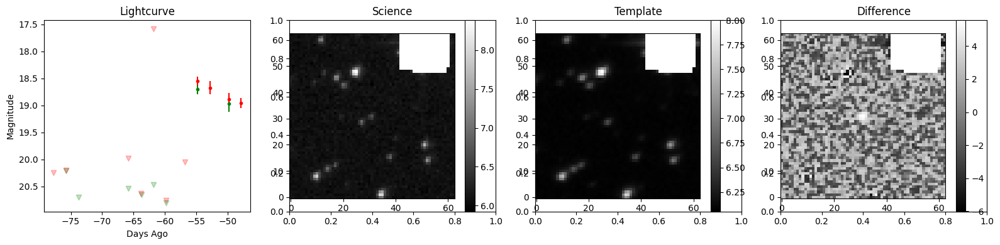

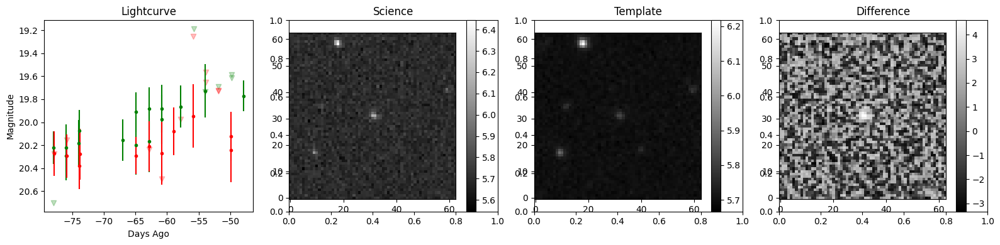

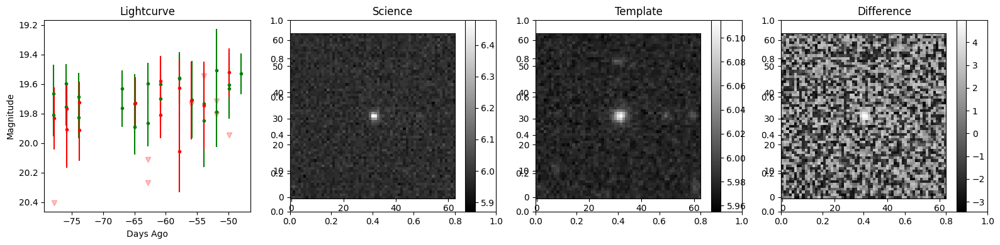

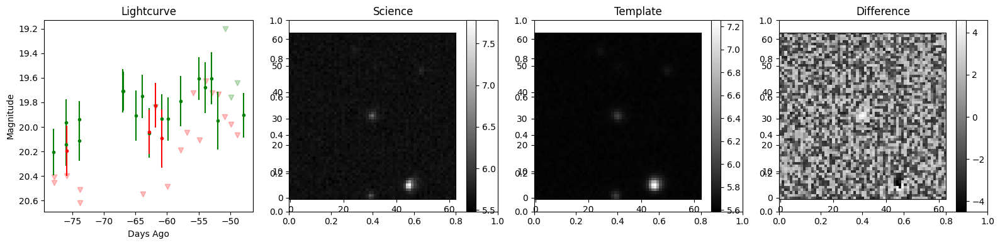

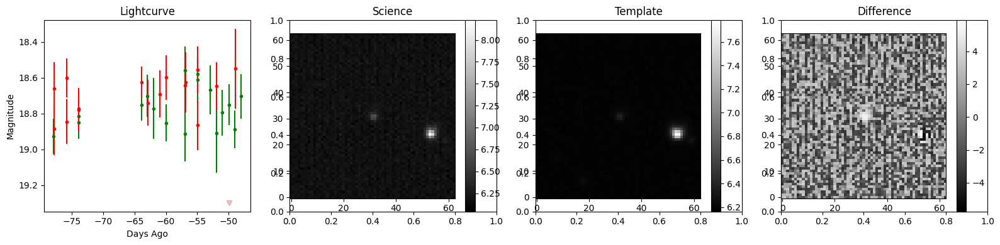

...

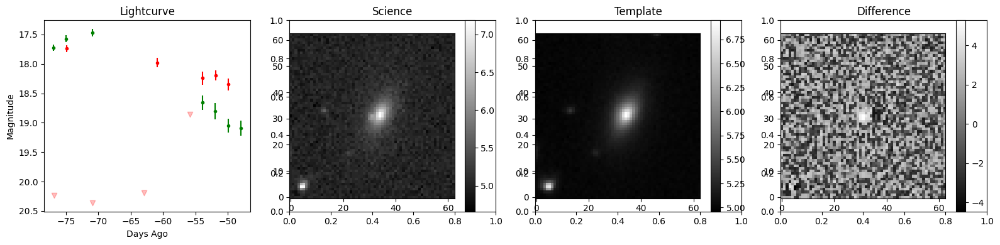

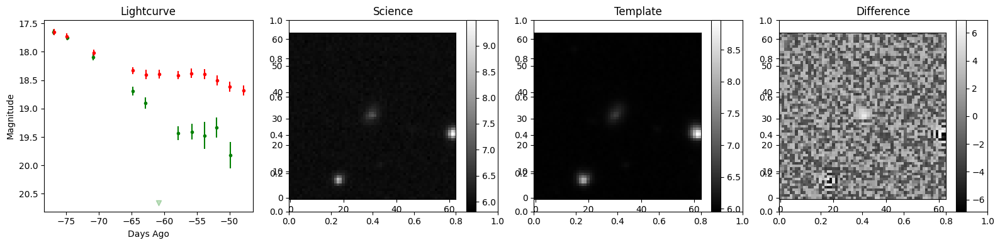

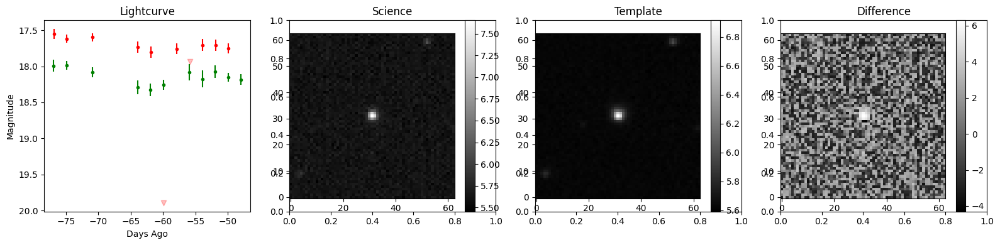

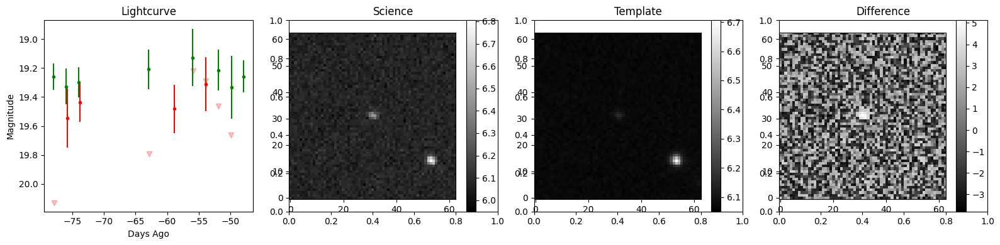

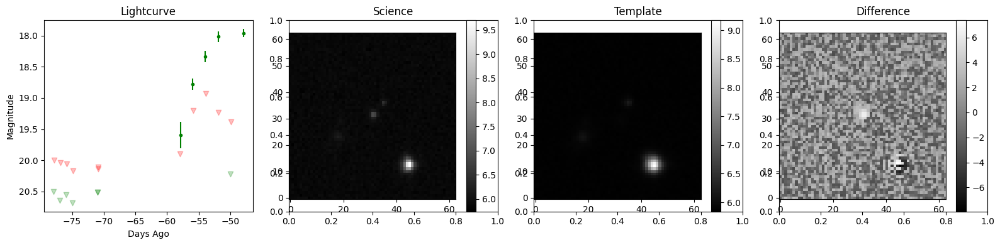

In [81]:
for packet in transient_alerts:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        show_all(packet)